In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from summitutils import training, datagen, dataset
from summitutils.convert_csv_to_detectron import convert_csv_to_json

In [3]:
import pandas as pd
import glob
import matplotlib.pylab as plt
from multiprocessing import Process

# Dataset preparation

Per class: 1280 images + color + real backgrounds

In [29]:
N_images = 1280*4
low_frac = 0.20 #0.05 before
high_frac = 0.60
save_loc_name = 'logo_detector_realbkg_large_expanded'

logo_file_list = ['RHLOGO.jpg',
                  'ANACONDALOGO.jpg',
                  'CLOUDERALOGO.jpg',
                  'SASLOGO.png']
name_list = [name.split('.')[0].replace('LOGO', '').lower() for name in logo_file_list]
print(name_list)

['rh', 'anaconda', 'cloudera', 'sas']


In [30]:
#Parallelize this
name = 'doublelogo'
for dataset in ['train', 'test']:
    img_list, bbox_list, csv_fields = datagen.generate_augmented_dataset(N_images, 
                                                                         low_frac=low_frac,
                                                                         high_frac=high_frac,
                                                                         logo_file=logo_file_list,
                                                                         logo_name=name_list,
                                                                         N_logos_per_image=2,
                                                                         N_tfms_to_apply=1,
                                                                         save_loc=f'{save_loc_name}/{name}/{dataset}',
                                                                         generate=False,
                                                                         bkg_loc='bkg_img')

In [31]:
dataset_name = 'logo_detector_realbkg_large_expanded'
name = "doublelogo"

for ds in ['train', 'test']:
    convert_csv_to_json(f'{dataset_name}/{name}/{ds}/labels.csv', f'{dataset_name}/{name}/{ds}/data.json')

# Training

In [48]:
dataset_name = 'logo_detector_realbkg_large_expanded/doublelogo'

In [49]:
training.unregister()

In [50]:
#get labels
labels = list(pd.read_csv(f'{dataset_name}/train/labels.csv')['class'].unique())
print(labels)

['anaconda', 'rh', 'sas', 'cloudera']


In [51]:
#register datasets
training.register(dataset_name, labels, ['train', 'test'])
logo_train_metadata = training.get_metadata(f'{dataset_name}_train')

In [52]:
logo_train_dict = training.get_dicts(dataset_name + '/train')

{'image_id': 460, 'file_name': 'logo_detector_realbkg_large_expanded/doublelogo/train/anaconda_cloudera_lomjqk.png', 'height': 512, 'width': 512, 'annotations': [{'bbox': [64, 133, 243, 312], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'category_id': 0}, {'bbox': [121, 44, 336, 259], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'category_id': 3}]}


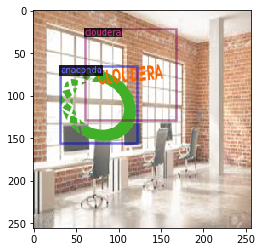

In [53]:
#plot data
training.sample_plot(logo_train_dict, logo_train_metadata, '.')

In [54]:
training.DatasetCatalog.list()

['logo_detector_realbkg_large_expanded/doublelogo_train',
 'logo_detector_realbkg_large_expanded/doublelogo_test']

In [55]:
N_classes = 4
trainer, cfg = training.prepare_for_training(20000, 
                                             f'{dataset_name}_output', 
                                             f'{dataset_name}_train', 
                                             N_classes,
                                             gpu_avail=True,
                                             start_training=True,
                                             model_type="COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")

[04/01 09:42:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[04/01 09:42:00 d2.data.build]: Removed 0 images with no usable annotations. 5120 images left.
[04/01 09:42:00 d2.data.common]: Serializing 5120 elements to byte tensors and concatenating them all ...
[04/01 09:42:00 d2.data.common]: Serialized dataset takes 1.42 MiB
[04/01 09:42:00 d2.data.detection_utils]: TransformGens used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[04/01 09:42:00 d2.data.build]: Using training sampler TrainingSampler


'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (5, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (5,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (16, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (16,) in the model! Skipped.


[04/01 09:42:00 d2.engine.train_loop]: Starting training from iteration 0
[04/01 09:42:06 d2.utils.events]:  eta: 1:23:45  iter: 19  total_loss: 1.940  loss_cls: 1.502  loss_box_reg: 0.372  loss_rpn_cls: 0.064  loss_rpn_loc: 0.016  time: 0.2517  data_time: 0.0162  lr: 0.000010  max_mem: 3347M
[04/01 09:42:11 d2.utils.events]:  eta: 1:26:46  iter: 39  total_loss: 1.887  loss_cls: 1.327  loss_box_reg: 0.451  loss_rpn_cls: 0.094  loss_rpn_loc: 0.015  time: 0.2579  data_time: 0.0028  lr: 0.000020  max_mem: 3347M
[04/01 09:42:16 d2.utils.events]:  eta: 1:26:01  iter: 59  total_loss: 1.624  loss_cls: 1.053  loss_box_reg: 0.488  loss_rpn_cls: 0.065  loss_rpn_loc: 0.015  time: 0.2564  data_time: 0.0030  lr: 0.000030  max_mem: 3347M
[04/01 09:42:21 d2.utils.events]:  eta: 1:26:07  iter: 79  total_loss: 1.288  loss_cls: 0.743  loss_box_reg: 0.471  loss_rpn_cls: 0.055  loss_rpn_loc: 0.013  time: 0.2581  data_time: 0.0031  lr: 0.000040  max_mem: 3347M
[04/01 09:42:26 d2.utils.events]:  eta: 1:26:0

[04/01 09:45:12 d2.utils.events]:  eta: 1:23:01  iter: 739  total_loss: 0.319  loss_cls: 0.066  loss_box_reg: 0.251  loss_rpn_cls: 0.000  loss_rpn_loc: 0.005  time: 0.2578  data_time: 0.0028  lr: 0.000250  max_mem: 3347M
[04/01 09:45:17 d2.utils.events]:  eta: 1:22:57  iter: 759  total_loss: 0.341  loss_cls: 0.080  loss_box_reg: 0.240  loss_rpn_cls: 0.000  loss_rpn_loc: 0.006  time: 0.2580  data_time: 0.0029  lr: 0.000250  max_mem: 3347M
[04/01 09:45:23 d2.utils.events]:  eta: 1:22:54  iter: 779  total_loss: 0.342  loss_cls: 0.093  loss_box_reg: 0.229  loss_rpn_cls: 0.000  loss_rpn_loc: 0.006  time: 0.2582  data_time: 0.0028  lr: 0.000250  max_mem: 3347M
[04/01 09:45:28 d2.utils.events]:  eta: 1:22:49  iter: 799  total_loss: 0.369  loss_cls: 0.105  loss_box_reg: 0.278  loss_rpn_cls: 0.000  loss_rpn_loc: 0.007  time: 0.2582  data_time: 0.0028  lr: 0.000250  max_mem: 3347M
[04/01 09:45:33 d2.utils.events]:  eta: 1:22:42  iter: 819  total_loss: 0.303  loss_cls: 0.064  loss_box_reg: 0.230 

[04/01 09:48:20 d2.utils.events]:  eta: 1:20:11  iter: 1459  total_loss: 0.242  loss_cls: 0.062  loss_box_reg: 0.171  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2589  data_time: 0.0031  lr: 0.000247  max_mem: 3347M
[04/01 09:48:25 d2.utils.events]:  eta: 1:20:07  iter: 1479  total_loss: 0.238  loss_cls: 0.052  loss_box_reg: 0.185  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2590  data_time: 0.0029  lr: 0.000247  max_mem: 3347M
[04/01 09:48:30 d2.utils.events]:  eta: 1:19:59  iter: 1499  total_loss: 0.220  loss_cls: 0.060  loss_box_reg: 0.150  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2590  data_time: 0.0029  lr: 0.000247  max_mem: 3347M
[04/01 09:48:36 d2.utils.events]:  eta: 1:19:55  iter: 1519  total_loss: 0.216  loss_cls: 0.061  loss_box_reg: 0.158  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2591  data_time: 0.0028  lr: 0.000247  max_mem: 3347M
[04/01 09:48:41 d2.utils.events]:  eta: 1:19:49  iter: 1539  total_loss: 0.187  loss_cls: 0.044  loss_box_reg: 0

[04/01 09:51:28 d2.utils.events]:  eta: 1:17:19  iter: 2179  total_loss: 0.206  loss_cls: 0.051  loss_box_reg: 0.157  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2595  data_time: 0.0027  lr: 0.000245  max_mem: 3347M
[04/01 09:51:33 d2.utils.events]:  eta: 1:17:13  iter: 2199  total_loss: 0.219  loss_cls: 0.043  loss_box_reg: 0.168  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2594  data_time: 0.0027  lr: 0.000245  max_mem: 3347M
[04/01 09:51:39 d2.utils.events]:  eta: 1:17:07  iter: 2219  total_loss: 0.168  loss_cls: 0.047  loss_box_reg: 0.120  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2594  data_time: 0.0029  lr: 0.000245  max_mem: 3347M
[04/01 09:51:44 d2.utils.events]:  eta: 1:16:59  iter: 2239  total_loss: 0.188  loss_cls: 0.046  loss_box_reg: 0.138  loss_rpn_cls: 0.000  loss_rpn_loc: 0.004  time: 0.2595  data_time: 0.0029  lr: 0.000245  max_mem: 3347M
[04/01 09:51:49 d2.utils.events]:  eta: 1:16:49  iter: 2259  total_loss: 0.163  loss_cls: 0.033  loss_box_reg: 0

[04/01 09:54:34 d2.utils.events]:  eta: 1:13:42  iter: 2899  total_loss: 0.170  loss_cls: 0.043  loss_box_reg: 0.131  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2590  data_time: 0.0029  lr: 0.000245  max_mem: 3347M
[04/01 09:54:39 d2.utils.events]:  eta: 1:13:36  iter: 2919  total_loss: 0.140  loss_cls: 0.041  loss_box_reg: 0.107  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2590  data_time: 0.0028  lr: 0.000245  max_mem: 3347M
[04/01 09:54:45 d2.utils.events]:  eta: 1:13:29  iter: 2939  total_loss: 0.143  loss_cls: 0.031  loss_box_reg: 0.112  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2590  data_time: 0.0027  lr: 0.000245  max_mem: 3347M
[04/01 09:54:50 d2.utils.events]:  eta: 1:13:24  iter: 2959  total_loss: 0.172  loss_cls: 0.037  loss_box_reg: 0.134  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2590  data_time: 0.0027  lr: 0.000245  max_mem: 3347M
[04/01 09:54:55 d2.utils.events]:  eta: 1:13:14  iter: 2979  total_loss: 0.165  loss_cls: 0.036  loss_box_reg: 0

[04/01 09:57:41 d2.utils.events]:  eta: 1:10:33  iter: 3619  total_loss: 0.123  loss_cls: 0.028  loss_box_reg: 0.093  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2589  data_time: 0.0029  lr: 0.000243  max_mem: 3347M
[04/01 09:57:46 d2.utils.events]:  eta: 1:10:26  iter: 3639  total_loss: 0.176  loss_cls: 0.041  loss_box_reg: 0.130  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2588  data_time: 0.0027  lr: 0.000243  max_mem: 3347M
[04/01 09:57:51 d2.utils.events]:  eta: 1:10:20  iter: 3659  total_loss: 0.147  loss_cls: 0.036  loss_box_reg: 0.107  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2589  data_time: 0.0028  lr: 0.000243  max_mem: 3347M
[04/01 09:57:56 d2.utils.events]:  eta: 1:10:13  iter: 3679  total_loss: 0.144  loss_cls: 0.041  loss_box_reg: 0.109  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2589  data_time: 0.0029  lr: 0.000243  max_mem: 3347M
[04/01 09:58:02 d2.utils.events]:  eta: 1:10:15  iter: 3699  total_loss: 0.169  loss_cls: 0.035  loss_box_reg: 0

[04/01 10:00:47 d2.utils.events]:  eta: 1:07:23  iter: 4339  total_loss: 0.168  loss_cls: 0.037  loss_box_reg: 0.118  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2587  data_time: 0.0028  lr: 0.000240  max_mem: 3347M
[04/01 10:00:52 d2.utils.events]:  eta: 1:07:15  iter: 4359  total_loss: 0.164  loss_cls: 0.027  loss_box_reg: 0.126  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2587  data_time: 0.0028  lr: 0.000240  max_mem: 3347M
[04/01 10:00:58 d2.utils.events]:  eta: 1:07:11  iter: 4379  total_loss: 0.133  loss_cls: 0.032  loss_box_reg: 0.107  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2587  data_time: 0.0031  lr: 0.000240  max_mem: 3347M
[04/01 10:01:03 d2.utils.events]:  eta: 1:07:03  iter: 4399  total_loss: 0.200  loss_cls: 0.035  loss_box_reg: 0.146  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2587  data_time: 0.0027  lr: 0.000240  max_mem: 3347M
[04/01 10:01:08 d2.utils.events]:  eta: 1:07:03  iter: 4419  total_loss: 0.146  loss_cls: 0.034  loss_box_reg: 0

[04/01 10:03:58 d2.utils.events]:  eta: 1:04:24  iter: 5059  total_loss: 0.122  loss_cls: 0.033  loss_box_reg: 0.095  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2588  data_time: 0.0028  lr: 0.000238  max_mem: 3347M
[04/01 10:04:03 d2.utils.events]:  eta: 1:04:20  iter: 5079  total_loss: 0.146  loss_cls: 0.028  loss_box_reg: 0.113  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2588  data_time: 0.0028  lr: 0.000238  max_mem: 3347M
[04/01 10:04:08 d2.utils.events]:  eta: 1:04:14  iter: 5099  total_loss: 0.149  loss_cls: 0.031  loss_box_reg: 0.118  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2588  data_time: 0.0028  lr: 0.000238  max_mem: 3347M
[04/01 10:04:14 d2.utils.events]:  eta: 1:04:10  iter: 5119  total_loss: 0.145  loss_cls: 0.029  loss_box_reg: 0.111  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2588  data_time: 0.0027  lr: 0.000238  max_mem: 3347M
[04/01 10:04:19 d2.utils.events]:  eta: 1:04:08  iter: 5139  total_loss: 0.158  loss_cls: 0.036  loss_box_reg: 0

[04/01 10:07:08 d2.utils.events]:  eta: 1:01:49  iter: 5779  total_loss: 0.130  loss_cls: 0.030  loss_box_reg: 0.101  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2593  data_time: 0.0031  lr: 0.000238  max_mem: 3347M
[04/01 10:07:13 d2.utils.events]:  eta: 1:01:48  iter: 5799  total_loss: 0.196  loss_cls: 0.046  loss_box_reg: 0.136  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2593  data_time: 0.0030  lr: 0.000238  max_mem: 3347M
[04/01 10:07:18 d2.utils.events]:  eta: 1:01:42  iter: 5819  total_loss: 0.141  loss_cls: 0.028  loss_box_reg: 0.105  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2593  data_time: 0.0030  lr: 0.000238  max_mem: 3347M
[04/01 10:07:24 d2.utils.events]:  eta: 1:01:40  iter: 5839  total_loss: 0.145  loss_cls: 0.035  loss_box_reg: 0.104  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2593  data_time: 0.0031  lr: 0.000238  max_mem: 3347M
[04/01 10:07:29 d2.utils.events]:  eta: 1:01:34  iter: 5859  total_loss: 0.161  loss_cls: 0.032  loss_box_reg: 0

[04/01 10:10:18 d2.utils.events]:  eta: 0:58:47  iter: 6499  total_loss: 0.128  loss_cls: 0.031  loss_box_reg: 0.108  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2597  data_time: 0.0036  lr: 0.000235  max_mem: 3347M
[04/01 10:10:23 d2.utils.events]:  eta: 0:58:45  iter: 6519  total_loss: 0.134  loss_cls: 0.028  loss_box_reg: 0.111  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2597  data_time: 0.0034  lr: 0.000235  max_mem: 3347M
[04/01 10:10:29 d2.utils.events]:  eta: 0:58:42  iter: 6539  total_loss: 0.159  loss_cls: 0.036  loss_box_reg: 0.116  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2597  data_time: 0.0041  lr: 0.000235  max_mem: 3347M
[04/01 10:10:34 d2.utils.events]:  eta: 0:58:44  iter: 6559  total_loss: 0.139  loss_cls: 0.033  loss_box_reg: 0.097  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2598  data_time: 0.0032  lr: 0.000235  max_mem: 3347M
[04/01 10:10:40 d2.utils.events]:  eta: 0:58:40  iter: 6579  total_loss: 0.130  loss_cls: 0.033  loss_box_reg: 0

[04/01 10:13:32 d2.utils.events]:  eta: 0:56:30  iter: 7219  total_loss: 0.109  loss_cls: 0.024  loss_box_reg: 0.089  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2605  data_time: 0.0035  lr: 0.000233  max_mem: 3347M
[04/01 10:13:37 d2.utils.events]:  eta: 0:56:25  iter: 7239  total_loss: 0.133  loss_cls: 0.031  loss_box_reg: 0.095  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2605  data_time: 0.0035  lr: 0.000233  max_mem: 3347M
[04/01 10:13:42 d2.utils.events]:  eta: 0:56:19  iter: 7259  total_loss: 0.137  loss_cls: 0.030  loss_box_reg: 0.098  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2605  data_time: 0.0035  lr: 0.000233  max_mem: 3347M
[04/01 10:13:48 d2.utils.events]:  eta: 0:56:17  iter: 7279  total_loss: 0.151  loss_cls: 0.031  loss_box_reg: 0.115  loss_rpn_cls: 0.000  loss_rpn_loc: 0.003  time: 0.2605  data_time: 0.0036  lr: 0.000233  max_mem: 3347M
[04/01 10:13:53 d2.utils.events]:  eta: 0:56:15  iter: 7299  total_loss: 0.114  loss_cls: 0.028  loss_box_reg: 0

[04/01 10:16:45 d2.utils.events]:  eta: 0:53:32  iter: 7939  total_loss: 0.102  loss_cls: 0.028  loss_box_reg: 0.078  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2611  data_time: 0.0034  lr: 0.000233  max_mem: 3347M
[04/01 10:16:50 d2.utils.events]:  eta: 0:53:26  iter: 7959  total_loss: 0.127  loss_cls: 0.026  loss_box_reg: 0.097  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2611  data_time: 0.0037  lr: 0.000233  max_mem: 3347M
[04/01 10:16:56 d2.utils.events]:  eta: 0:53:22  iter: 7979  total_loss: 0.103  loss_cls: 0.021  loss_box_reg: 0.081  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2611  data_time: 0.0036  lr: 0.000233  max_mem: 3347M
[04/01 10:17:01 d2.utils.events]:  eta: 0:53:16  iter: 7999  total_loss: 0.137  loss_cls: 0.032  loss_box_reg: 0.114  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2611  data_time: 0.0036  lr: 0.000233  max_mem: 3347M
[04/01 10:17:06 d2.utils.events]:  eta: 0:53:09  iter: 8019  total_loss: 0.130  loss_cls: 0.031  loss_box_reg: 0

[04/01 10:19:57 d2.utils.events]:  eta: 0:50:15  iter: 8659  total_loss: 0.129  loss_cls: 0.023  loss_box_reg: 0.095  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2615  data_time: 0.0033  lr: 0.000231  max_mem: 3347M
[04/01 10:20:03 d2.utils.events]:  eta: 0:50:11  iter: 8679  total_loss: 0.093  loss_cls: 0.025  loss_box_reg: 0.075  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2615  data_time: 0.0036  lr: 0.000231  max_mem: 3347M
[04/01 10:20:08 d2.utils.events]:  eta: 0:50:07  iter: 8699  total_loss: 0.124  loss_cls: 0.027  loss_box_reg: 0.098  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2615  data_time: 0.0034  lr: 0.000231  max_mem: 3347M
[04/01 10:20:13 d2.utils.events]:  eta: 0:50:01  iter: 8719  total_loss: 0.095  loss_cls: 0.020  loss_box_reg: 0.080  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2615  data_time: 0.0034  lr: 0.000231  max_mem: 3347M
[04/01 10:20:18 d2.utils.events]:  eta: 0:49:54  iter: 8739  total_loss: 0.117  loss_cls: 0.031  loss_box_reg: 0

[04/01 10:23:10 d2.utils.events]:  eta: 0:47:11  iter: 9379  total_loss: 0.129  loss_cls: 0.032  loss_box_reg: 0.096  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2619  data_time: 0.0043  lr: 0.000228  max_mem: 3347M
[04/01 10:23:16 d2.utils.events]:  eta: 0:47:05  iter: 9399  total_loss: 0.089  loss_cls: 0.026  loss_box_reg: 0.069  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2619  data_time: 0.0037  lr: 0.000228  max_mem: 3347M
[04/01 10:23:21 d2.utils.events]:  eta: 0:47:02  iter: 9419  total_loss: 0.102  loss_cls: 0.025  loss_box_reg: 0.074  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2619  data_time: 0.0042  lr: 0.000228  max_mem: 3347M
[04/01 10:23:27 d2.utils.events]:  eta: 0:46:58  iter: 9439  total_loss: 0.125  loss_cls: 0.027  loss_box_reg: 0.103  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2620  data_time: 0.0035  lr: 0.000228  max_mem: 3347M
[04/01 10:23:32 d2.utils.events]:  eta: 0:46:53  iter: 9459  total_loss: 0.104  loss_cls: 0.021  loss_box_reg: 0

[04/01 10:26:28 d2.utils.events]:  eta: 0:44:18  iter: 10099  total_loss: 0.101  loss_cls: 0.021  loss_box_reg: 0.076  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2624  data_time: 0.0034  lr: 0.000226  max_mem: 3347M
[04/01 10:26:33 d2.utils.events]:  eta: 0:44:12  iter: 10119  total_loss: 0.096  loss_cls: 0.025  loss_box_reg: 0.071  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2624  data_time: 0.0033  lr: 0.000226  max_mem: 3347M
[04/01 10:26:38 d2.utils.events]:  eta: 0:44:06  iter: 10139  total_loss: 0.095  loss_cls: 0.019  loss_box_reg: 0.075  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2624  data_time: 0.0035  lr: 0.000226  max_mem: 3347M
[04/01 10:26:44 d2.utils.events]:  eta: 0:44:02  iter: 10159  total_loss: 0.109  loss_cls: 0.024  loss_box_reg: 0.077  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2624  data_time: 0.0041  lr: 0.000226  max_mem: 3347M
[04/01 10:26:49 d2.utils.events]:  eta: 0:43:57  iter: 10179  total_loss: 0.131  loss_cls: 0.024  loss_box_r

[04/01 10:29:43 d2.utils.events]:  eta: 0:41:09  iter: 10819  total_loss: 0.109  loss_cls: 0.025  loss_box_reg: 0.075  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2628  data_time: 0.0049  lr: 0.000226  max_mem: 3347M
[04/01 10:29:48 d2.utils.events]:  eta: 0:41:04  iter: 10839  total_loss: 0.097  loss_cls: 0.021  loss_box_reg: 0.073  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2628  data_time: 0.0045  lr: 0.000226  max_mem: 3347M
[04/01 10:29:54 d2.utils.events]:  eta: 0:40:58  iter: 10859  total_loss: 0.131  loss_cls: 0.028  loss_box_reg: 0.097  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2629  data_time: 0.0052  lr: 0.000226  max_mem: 3347M
[04/01 10:29:59 d2.utils.events]:  eta: 0:40:53  iter: 10879  total_loss: 0.120  loss_cls: 0.027  loss_box_reg: 0.093  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2629  data_time: 0.0046  lr: 0.000226  max_mem: 3347M
[04/01 10:30:05 d2.utils.events]:  eta: 0:40:47  iter: 10899  total_loss: 0.108  loss_cls: 0.026  loss_box_r

[04/01 10:32:58 d2.utils.events]:  eta: 0:37:49  iter: 11539  total_loss: 0.104  loss_cls: 0.023  loss_box_reg: 0.081  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2632  data_time: 0.0038  lr: 0.000224  max_mem: 3347M
[04/01 10:33:03 d2.utils.events]:  eta: 0:37:45  iter: 11559  total_loss: 0.107  loss_cls: 0.020  loss_box_reg: 0.085  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2632  data_time: 0.0046  lr: 0.000224  max_mem: 3347M
[04/01 10:33:09 d2.utils.events]:  eta: 0:37:37  iter: 11579  total_loss: 0.084  loss_cls: 0.019  loss_box_reg: 0.063  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2633  data_time: 0.0042  lr: 0.000224  max_mem: 3347M
[04/01 10:33:14 d2.utils.events]:  eta: 0:37:31  iter: 11599  total_loss: 0.091  loss_cls: 0.023  loss_box_reg: 0.073  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2632  data_time: 0.0039  lr: 0.000224  max_mem: 3347M
[04/01 10:33:19 d2.utils.events]:  eta: 0:37:27  iter: 11619  total_loss: 0.110  loss_cls: 0.028  loss_box_r

[04/01 10:36:12 d2.utils.events]:  eta: 0:34:35  iter: 12259  total_loss: 0.117  loss_cls: 0.021  loss_box_reg: 0.092  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2635  data_time: 0.0040  lr: 0.000222  max_mem: 3347M
[04/01 10:36:17 d2.utils.events]:  eta: 0:34:29  iter: 12279  total_loss: 0.100  loss_cls: 0.021  loss_box_reg: 0.079  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2635  data_time: 0.0038  lr: 0.000222  max_mem: 3347M
[04/01 10:36:23 d2.utils.events]:  eta: 0:34:22  iter: 12299  total_loss: 0.085  loss_cls: 0.017  loss_box_reg: 0.069  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2635  data_time: 0.0037  lr: 0.000222  max_mem: 3347M
[04/01 10:36:28 d2.utils.events]:  eta: 0:34:15  iter: 12319  total_loss: 0.105  loss_cls: 0.021  loss_box_reg: 0.086  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2635  data_time: 0.0037  lr: 0.000222  max_mem: 3347M
[04/01 10:36:33 d2.utils.events]:  eta: 0:34:10  iter: 12339  total_loss: 0.138  loss_cls: 0.032  loss_box_r

[04/01 10:39:25 d2.utils.events]:  eta: 0:31:14  iter: 12979  total_loss: 0.094  loss_cls: 0.018  loss_box_reg: 0.074  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2637  data_time: 0.0035  lr: 0.000222  max_mem: 3347M
[04/01 10:39:30 d2.utils.events]:  eta: 0:31:09  iter: 12999  total_loss: 0.091  loss_cls: 0.024  loss_box_reg: 0.063  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2637  data_time: 0.0032  lr: 0.000222  max_mem: 3347M
[04/01 10:39:35 d2.utils.events]:  eta: 0:31:04  iter: 13019  total_loss: 0.119  loss_cls: 0.032  loss_box_reg: 0.086  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2637  data_time: 0.0039  lr: 0.000219  max_mem: 3347M
[04/01 10:39:41 d2.utils.events]:  eta: 0:30:58  iter: 13039  total_loss: 0.095  loss_cls: 0.024  loss_box_reg: 0.066  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2637  data_time: 0.0042  lr: 0.000219  max_mem: 3347M
[04/01 10:39:46 d2.utils.events]:  eta: 0:30:52  iter: 13059  total_loss: 0.132  loss_cls: 0.030  loss_box_r

[04/01 10:42:39 d2.utils.events]:  eta: 0:28:02  iter: 13699  total_loss: 0.099  loss_cls: 0.024  loss_box_reg: 0.072  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2639  data_time: 0.0038  lr: 0.000219  max_mem: 3347M
[04/01 10:42:44 d2.utils.events]:  eta: 0:27:57  iter: 13719  total_loss: 0.103  loss_cls: 0.022  loss_box_reg: 0.080  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2639  data_time: 0.0035  lr: 0.000219  max_mem: 3347M
[04/01 10:42:49 d2.utils.events]:  eta: 0:27:52  iter: 13739  total_loss: 0.090  loss_cls: 0.019  loss_box_reg: 0.072  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2639  data_time: 0.0037  lr: 0.000219  max_mem: 3347M
[04/01 10:42:55 d2.utils.events]:  eta: 0:27:47  iter: 13759  total_loss: 0.089  loss_cls: 0.019  loss_box_reg: 0.069  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2639  data_time: 0.0033  lr: 0.000219  max_mem: 3347M
[04/01 10:43:00 d2.utils.events]:  eta: 0:27:41  iter: 13779  total_loss: 0.096  loss_cls: 0.023  loss_box_r

[04/01 10:45:53 d2.utils.events]:  eta: 0:24:53  iter: 14419  total_loss: 0.113  loss_cls: 0.023  loss_box_reg: 0.087  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2641  data_time: 0.0034  lr: 0.000217  max_mem: 3347M
[04/01 10:45:58 d2.utils.events]:  eta: 0:24:47  iter: 14439  total_loss: 0.080  loss_cls: 0.020  loss_box_reg: 0.061  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2641  data_time: 0.0037  lr: 0.000217  max_mem: 3347M
[04/01 10:46:03 d2.utils.events]:  eta: 0:24:43  iter: 14459  total_loss: 0.078  loss_cls: 0.017  loss_box_reg: 0.056  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2641  data_time: 0.0037  lr: 0.000217  max_mem: 3347M
[04/01 10:46:09 d2.utils.events]:  eta: 0:24:38  iter: 14479  total_loss: 0.105  loss_cls: 0.018  loss_box_reg: 0.081  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2641  data_time: 0.0041  lr: 0.000217  max_mem: 3347M
[04/01 10:46:14 d2.utils.events]:  eta: 0:24:31  iter: 14499  total_loss: 0.128  loss_cls: 0.027  loss_box_r

[04/01 10:49:09 d2.utils.events]:  eta: 0:21:36  iter: 15139  total_loss: 0.100  loss_cls: 0.024  loss_box_reg: 0.079  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2643  data_time: 0.0037  lr: 0.000215  max_mem: 3347M
[04/01 10:49:15 d2.utils.events]:  eta: 0:21:31  iter: 15159  total_loss: 0.109  loss_cls: 0.017  loss_box_reg: 0.091  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2643  data_time: 0.0037  lr: 0.000215  max_mem: 3347M
[04/01 10:49:20 d2.utils.events]:  eta: 0:21:26  iter: 15179  total_loss: 0.094  loss_cls: 0.013  loss_box_reg: 0.078  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2643  data_time: 0.0037  lr: 0.000215  max_mem: 3347M
[04/01 10:49:26 d2.utils.events]:  eta: 0:21:21  iter: 15199  total_loss: 0.092  loss_cls: 0.029  loss_box_reg: 0.075  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2643  data_time: 0.0033  lr: 0.000215  max_mem: 3347M
[04/01 10:49:31 d2.utils.events]:  eta: 0:21:15  iter: 15219  total_loss: 0.085  loss_cls: 0.024  loss_box_r

[04/01 10:52:24 d2.utils.events]:  eta: 0:18:27  iter: 15859  total_loss: 0.104  loss_cls: 0.019  loss_box_reg: 0.076  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2645  data_time: 0.0039  lr: 0.000215  max_mem: 3347M
[04/01 10:52:30 d2.utils.events]:  eta: 0:18:22  iter: 15879  total_loss: 0.078  loss_cls: 0.017  loss_box_reg: 0.061  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2645  data_time: 0.0036  lr: 0.000215  max_mem: 3347M
[04/01 10:52:35 d2.utils.events]:  eta: 0:18:15  iter: 15899  total_loss: 0.090  loss_cls: 0.022  loss_box_reg: 0.065  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2645  data_time: 0.0034  lr: 0.000215  max_mem: 3347M
[04/01 10:52:40 d2.utils.events]:  eta: 0:18:10  iter: 15919  total_loss: 0.086  loss_cls: 0.017  loss_box_reg: 0.060  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2645  data_time: 0.0045  lr: 0.000215  max_mem: 3347M
[04/01 10:52:45 d2.utils.events]:  eta: 0:18:05  iter: 15939  total_loss: 0.084  loss_cls: 0.019  loss_box_r

[04/01 10:55:38 d2.utils.events]:  eta: 0:15:13  iter: 16579  total_loss: 0.087  loss_cls: 0.021  loss_box_reg: 0.063  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2646  data_time: 0.0037  lr: 0.000213  max_mem: 3347M
[04/01 10:55:43 d2.utils.events]:  eta: 0:15:08  iter: 16599  total_loss: 0.113  loss_cls: 0.022  loss_box_reg: 0.083  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2647  data_time: 0.0040  lr: 0.000213  max_mem: 3347M
[04/01 10:55:49 d2.utils.events]:  eta: 0:15:03  iter: 16619  total_loss: 0.101  loss_cls: 0.023  loss_box_reg: 0.079  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2647  data_time: 0.0039  lr: 0.000213  max_mem: 3347M
[04/01 10:55:55 d2.utils.events]:  eta: 0:14:59  iter: 16639  total_loss: 0.088  loss_cls: 0.021  loss_box_reg: 0.068  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2647  data_time: 0.0036  lr: 0.000213  max_mem: 3347M
[04/01 10:56:00 d2.utils.events]:  eta: 0:14:55  iter: 16659  total_loss: 0.087  loss_cls: 0.020  loss_box_r

[04/01 10:58:51 d2.utils.events]:  eta: 0:12:01  iter: 17299  total_loss: 0.080  loss_cls: 0.019  loss_box_reg: 0.065  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2647  data_time: 0.0037  lr: 0.000211  max_mem: 3347M
[04/01 10:58:56 d2.utils.events]:  eta: 0:11:56  iter: 17319  total_loss: 0.115  loss_cls: 0.023  loss_box_reg: 0.085  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2647  data_time: 0.0036  lr: 0.000211  max_mem: 3347M
[04/01 10:59:02 d2.utils.events]:  eta: 0:11:51  iter: 17339  total_loss: 0.102  loss_cls: 0.021  loss_box_reg: 0.077  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2647  data_time: 0.0035  lr: 0.000211  max_mem: 3347M
[04/01 10:59:07 d2.utils.events]:  eta: 0:11:45  iter: 17359  total_loss: 0.110  loss_cls: 0.023  loss_box_reg: 0.079  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2647  data_time: 0.0035  lr: 0.000211  max_mem: 3347M
[04/01 10:59:12 d2.utils.events]:  eta: 0:11:40  iter: 17379  total_loss: 0.093  loss_cls: 0.021  loss_box_r

[04/01 11:02:05 d2.utils.events]:  eta: 0:08:45  iter: 18019  total_loss: 0.085  loss_cls: 0.022  loss_box_reg: 0.062  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2649  data_time: 0.0041  lr: 0.000209  max_mem: 3347M
[04/01 11:02:10 d2.utils.events]:  eta: 0:08:39  iter: 18039  total_loss: 0.105  loss_cls: 0.019  loss_box_reg: 0.076  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2649  data_time: 0.0039  lr: 0.000209  max_mem: 3347M
[04/01 11:02:16 d2.utils.events]:  eta: 0:08:34  iter: 18059  total_loss: 0.121  loss_cls: 0.026  loss_box_reg: 0.090  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2649  data_time: 0.0037  lr: 0.000209  max_mem: 3347M
[04/01 11:02:21 d2.utils.events]:  eta: 0:08:29  iter: 18079  total_loss: 0.077  loss_cls: 0.013  loss_box_reg: 0.058  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2649  data_time: 0.0038  lr: 0.000209  max_mem: 3347M
[04/01 11:02:27 d2.utils.events]:  eta: 0:08:24  iter: 18099  total_loss: 0.074  loss_cls: 0.014  loss_box_r

[04/01 11:05:18 d2.utils.events]:  eta: 0:05:37  iter: 18739  total_loss: 0.091  loss_cls: 0.020  loss_box_reg: 0.069  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2650  data_time: 0.0036  lr: 0.000209  max_mem: 3347M
[04/01 11:05:24 d2.utils.events]:  eta: 0:05:31  iter: 18759  total_loss: 0.088  loss_cls: 0.018  loss_box_reg: 0.070  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2650  data_time: 0.0033  lr: 0.000209  max_mem: 3347M
[04/01 11:05:29 d2.utils.events]:  eta: 0:05:26  iter: 18779  total_loss: 0.105  loss_cls: 0.027  loss_box_reg: 0.086  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2650  data_time: 0.0032  lr: 0.000209  max_mem: 3347M
[04/01 11:05:34 d2.utils.events]:  eta: 0:05:21  iter: 18799  total_loss: 0.092  loss_cls: 0.016  loss_box_reg: 0.071  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2650  data_time: 0.0037  lr: 0.000209  max_mem: 3347M
[04/01 11:05:40 d2.utils.events]:  eta: 0:05:15  iter: 18819  total_loss: 0.108  loss_cls: 0.024  loss_box_r

[04/01 11:08:32 d2.utils.events]:  eta: 0:02:24  iter: 19459  total_loss: 0.097  loss_cls: 0.022  loss_box_reg: 0.078  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2651  data_time: 0.0035  lr: 0.000207  max_mem: 3347M
[04/01 11:08:37 d2.utils.events]:  eta: 0:02:19  iter: 19479  total_loss: 0.076  loss_cls: 0.020  loss_box_reg: 0.061  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2651  data_time: 0.0033  lr: 0.000207  max_mem: 3347M
[04/01 11:08:42 d2.utils.events]:  eta: 0:02:13  iter: 19499  total_loss: 0.108  loss_cls: 0.026  loss_box_reg: 0.084  loss_rpn_cls: 0.000  loss_rpn_loc: 0.002  time: 0.2651  data_time: 0.0034  lr: 0.000207  max_mem: 3347M
[04/01 11:08:48 d2.utils.events]:  eta: 0:02:08  iter: 19519  total_loss: 0.093  loss_cls: 0.018  loss_box_reg: 0.074  loss_rpn_cls: 0.000  loss_rpn_loc: 0.001  time: 0.2651  data_time: 0.0035  lr: 0.000207  max_mem: 3347M
[04/01 11:08:53 d2.utils.events]:  eta: 0:02:03  iter: 19539  total_loss: 0.066  loss_cls: 0.016  loss_box_r

# Inference

In [76]:
dataset_name = 'logo_detector_realbkg_large_expanded/combined'

In [77]:
training.unregister()

In [127]:
#get labels
labels = list(pd.read_csv(f'{dataset_name}/train/labels.csv')['class'].unique())
print(labels)

['sas', 'rh', 'anaconda', 'cloudera']


In [79]:
#register datasets
training.register(dataset_name, labels, ['train', 'test'])
logo_train_metadata = training.get_metadata(f'{dataset_name}_train')

In [92]:
N_classes = 4
trainer, cfg = training.prepare_for_training(2000, 
                                             f'{dataset_name}_output', 
                                             f'{dataset_name}_train', 
                                             N_classes,
                                             gpu_avail=True,
                                             start_training=False,
                                             model_type="COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
predictor = training.prepare_for_inference(cfg, f'{dataset_name}_test', threshold=0.50)

[04/01 11:48:59 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[04/01 11:48:59 d2.data.build]: Removed 0 images with no usable annotations. 5120 images left.
[04/01 11:48:59 d2.data.common]: Serializing 5120 elements to byte tensors and concatenating them all ...
[04/01 11:48:59 d2.data.common]: Serialized dataset takes 1.24 MiB
[04/01 11:48:59 d2.data.detection_utils]: TransformGens used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[04/01 11:48:59 d2.data.build]: Using training sampler TrainingSampler


'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (5, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (5,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (16, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (16,) in the model! Skipped.


Reading weights from output dir: logo_detector_realbkg_large_expanded/combined_output


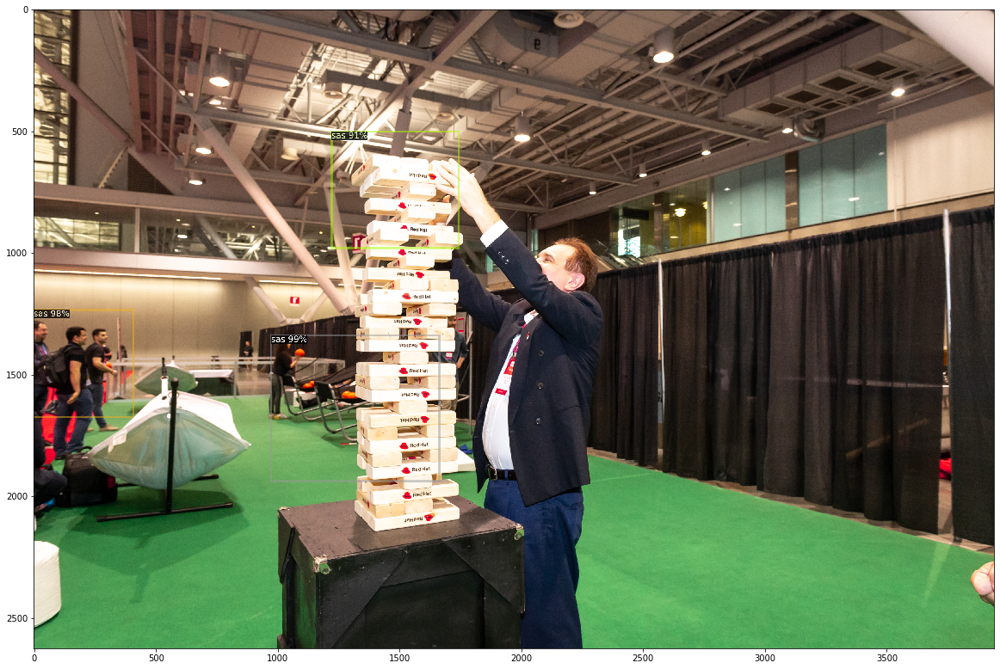

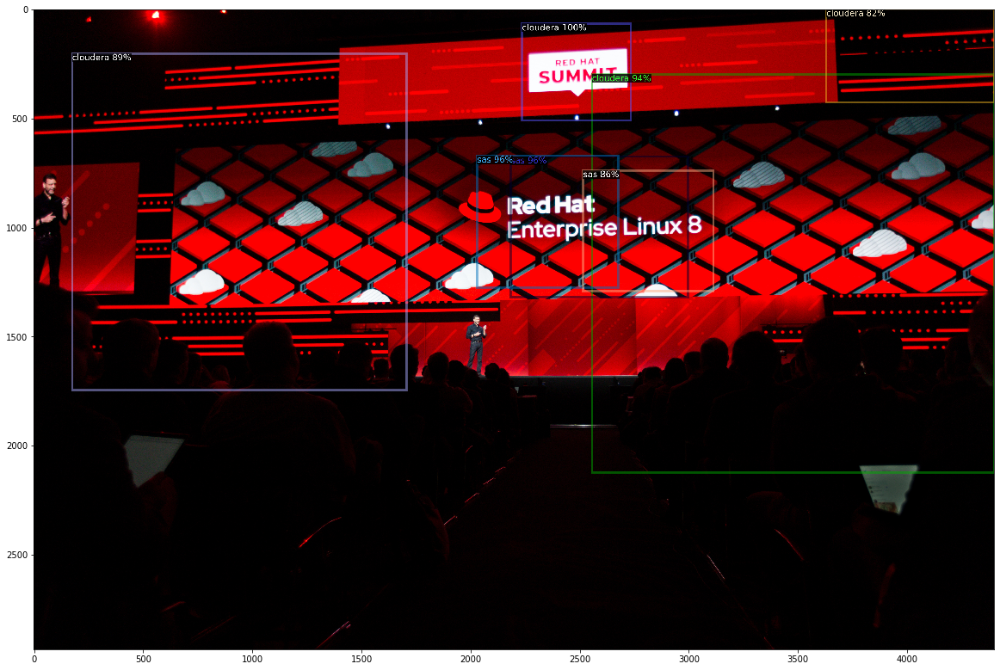

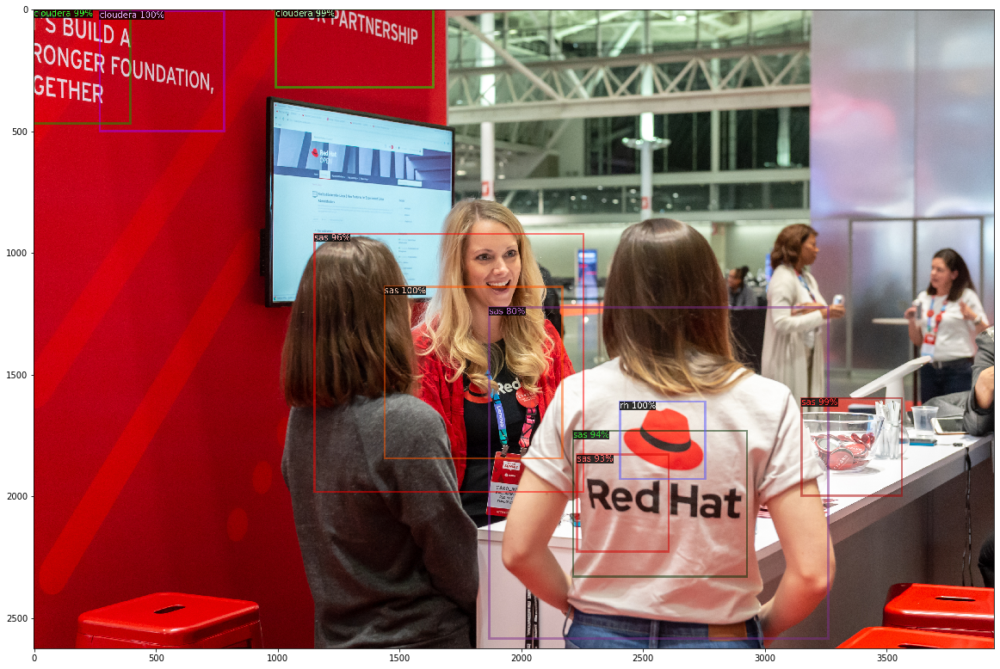

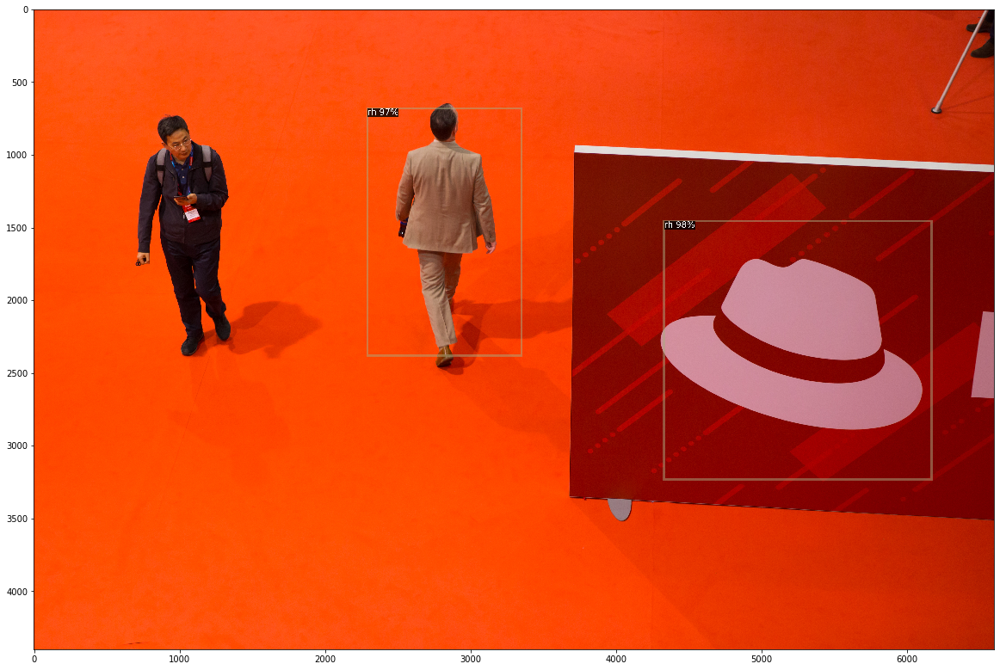

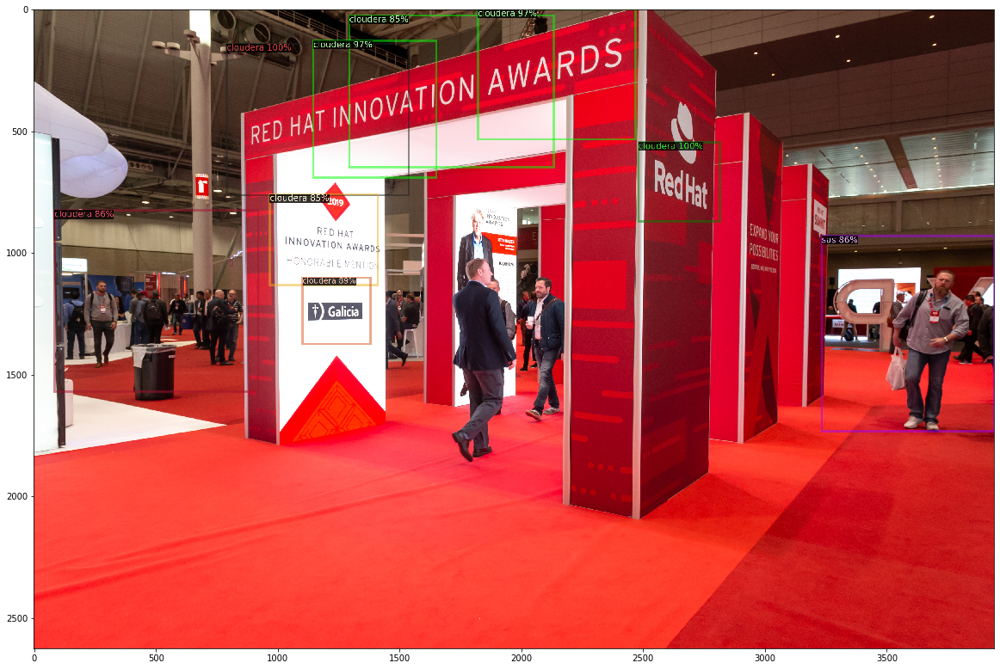

...

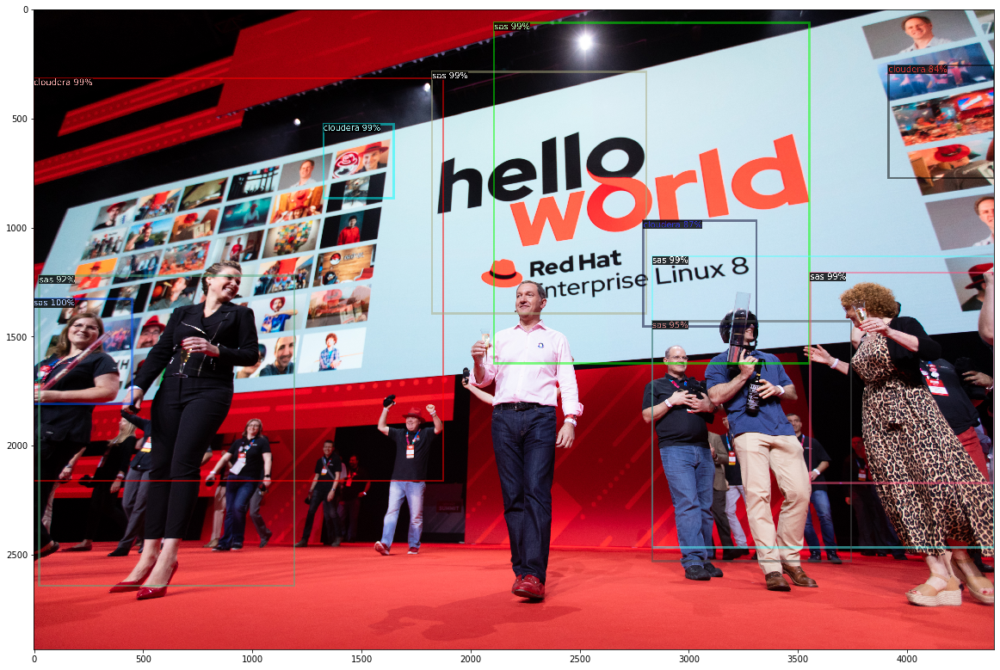

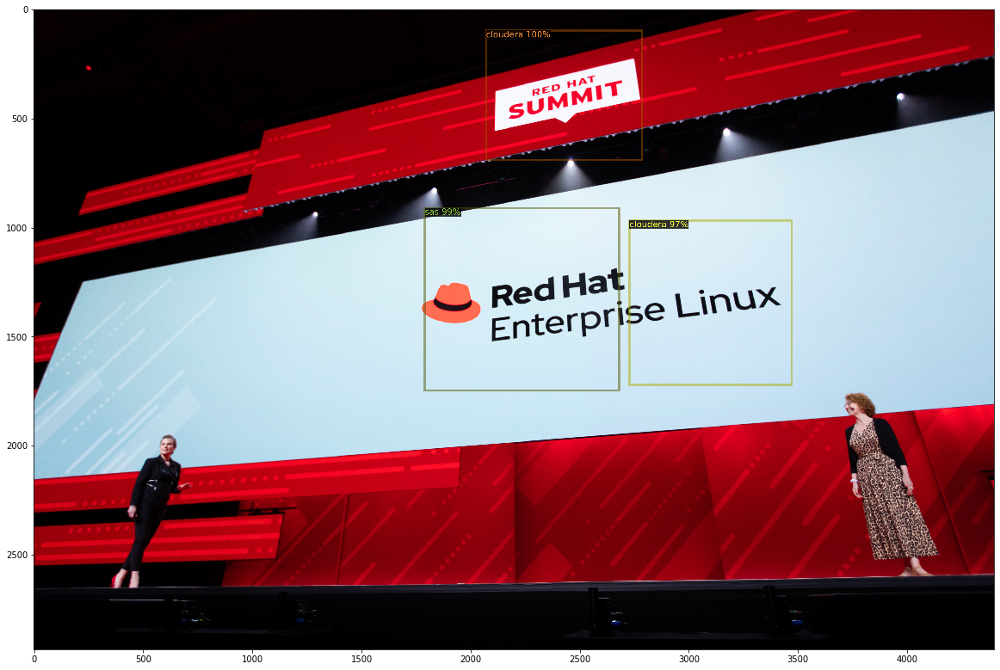

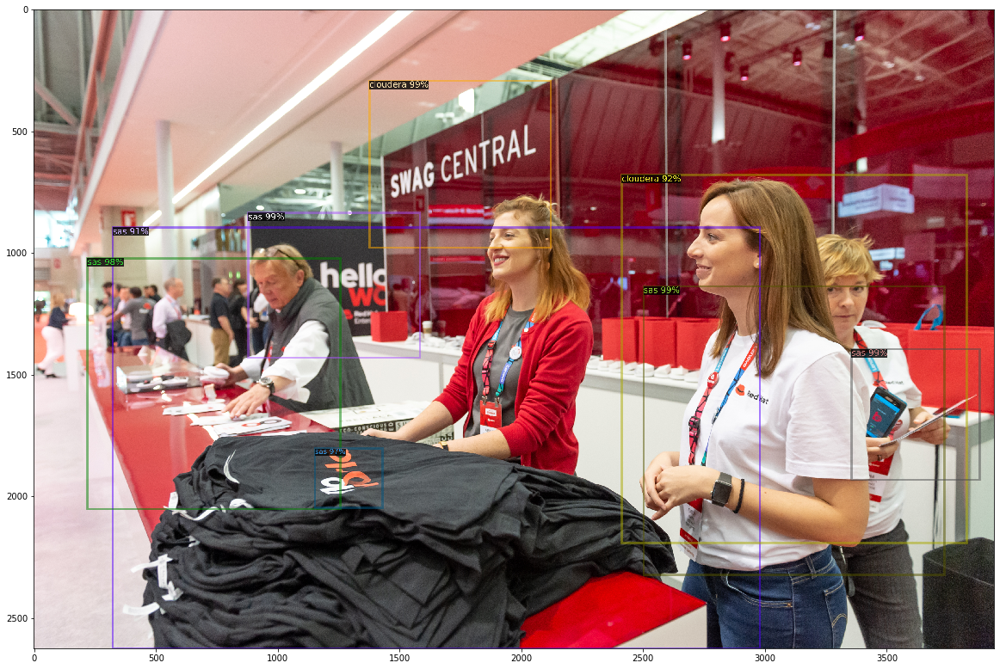

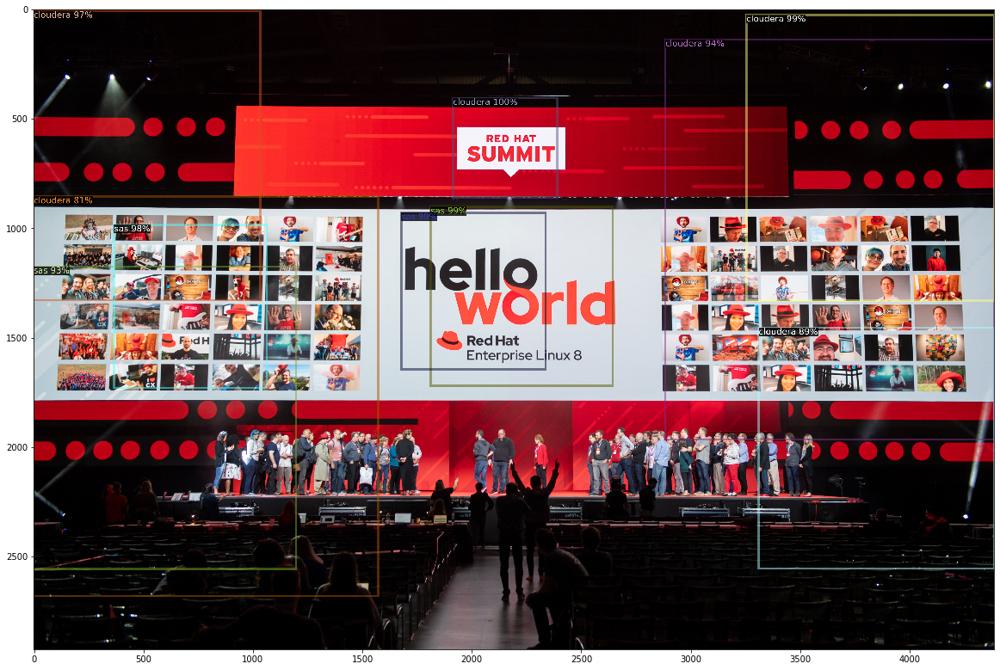

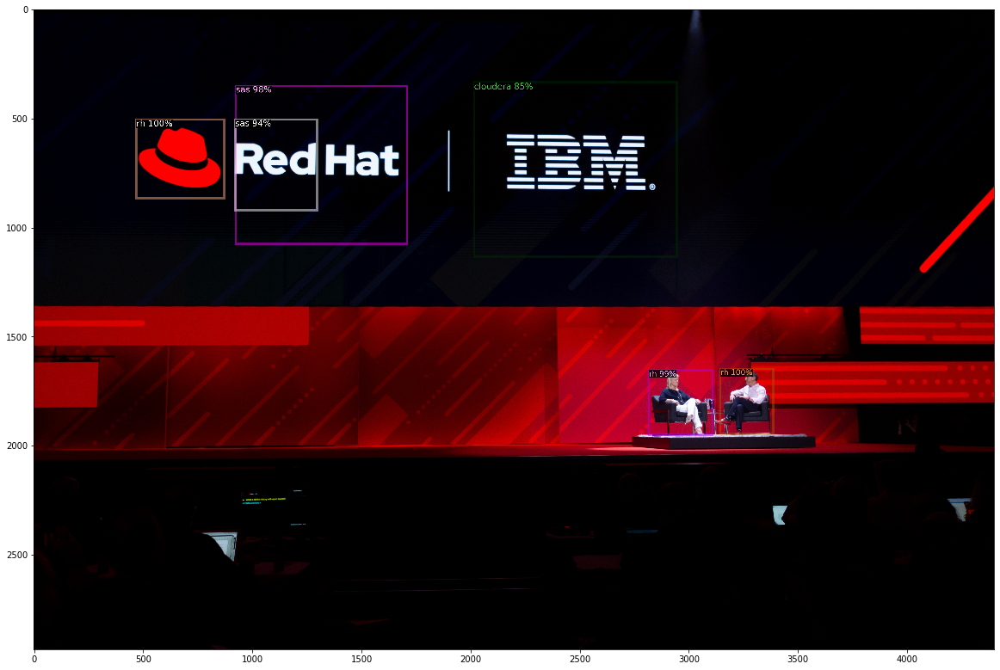

In [66]:
for img in glob.glob('rhlogo_summit_val/*'):
    plt.figure(figsize=(20,20))
    outputs = training.infer_img_v2(predictor, img, logo_train_metadata)

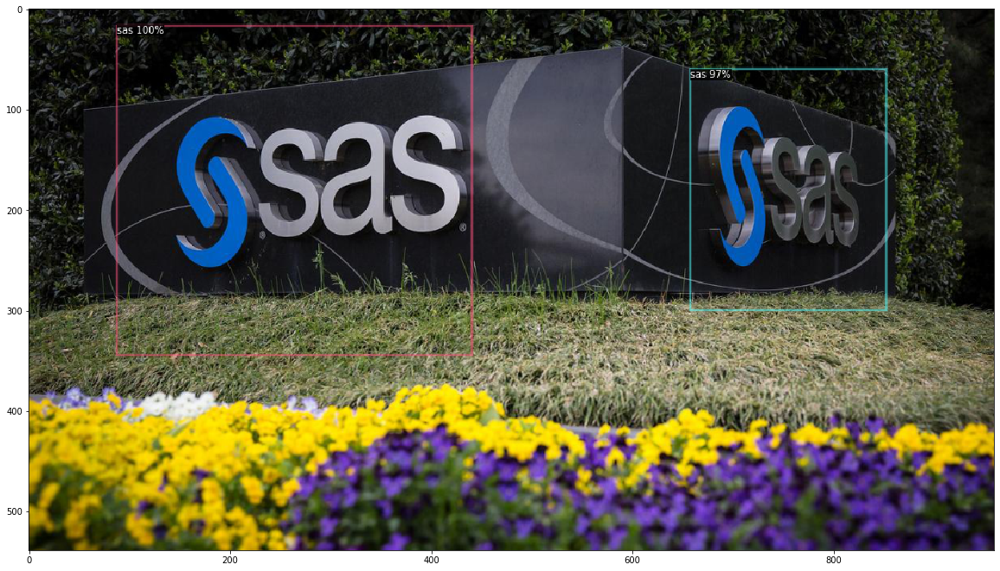

In [85]:
img = 'sasimage.jpg'
plt.figure(figsize=(20,20))
outputs = training.infer_img_v2(predictor, img, logo_train_metadata)

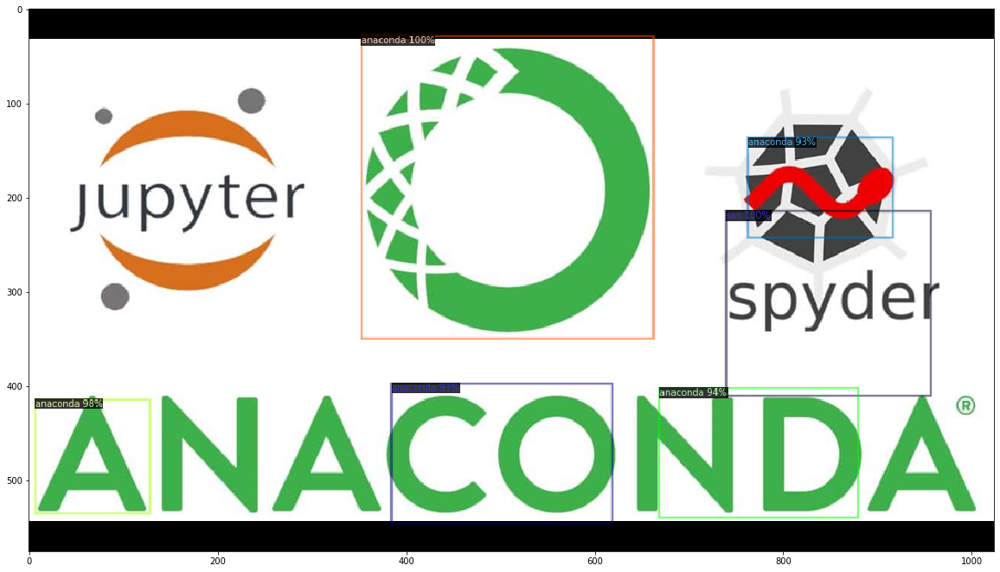

In [86]:
img = 'anacondaimage.jpg'
plt.figure(figsize=(20,20))
outputs = training.infer_img_v2(predictor, img, logo_train_metadata)

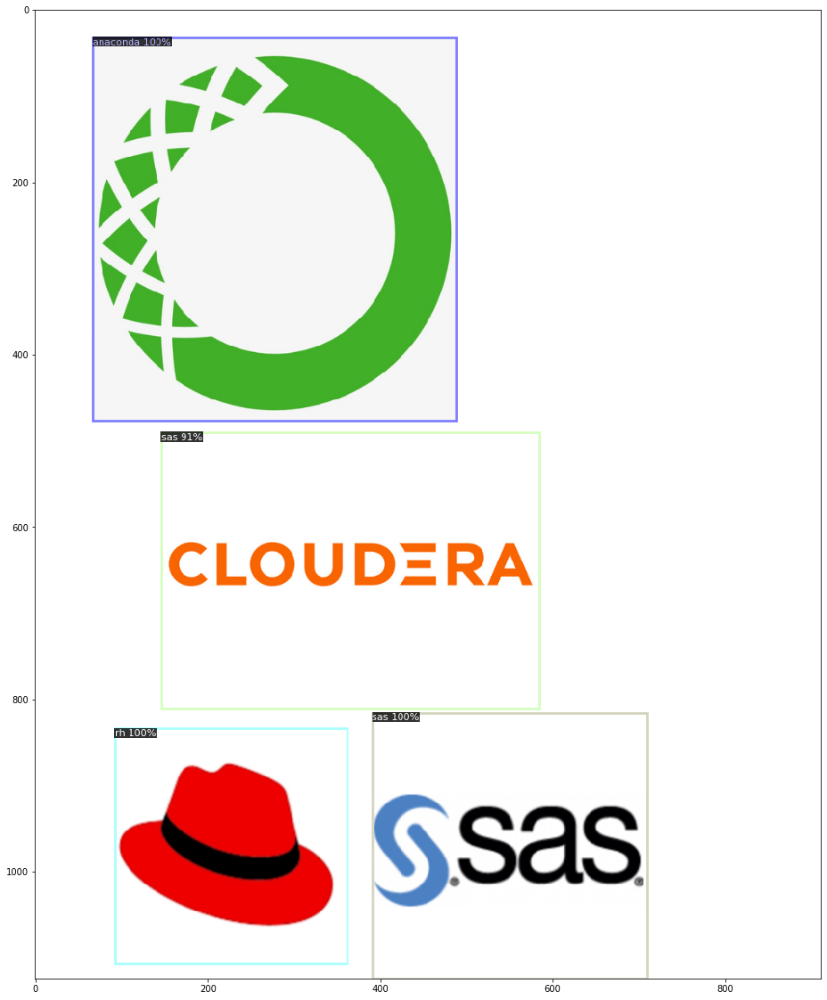

In [87]:
img = 'summitlogos.png'
plt.figure(figsize=(20,20))
outputs = training.infer_img_v2(predictor, img, logo_train_metadata)

In [129]:
import numpy as np
from PIL import Image, ImageDraw

def visualize_pred(img, bbox, labels, scores, thresholds = {'rh': 0.95, 'anaconda': 0.95, 'sas': 0.95, 'cloudera': 0.50}):
    img_copy = img.copy()
    draw = ImageDraw.Draw(img_copy)
    
    for idx, box in enumerate(bbox):
        print(box)

        if scores[idx] > thresholds[labels[idx]]:
            draw.rectangle([(box[0],box[1]), (box[2],box[3])], outline=128)
            draw.text((box[0],box[1]), labels[idx], fill=0)
    
    return img_copy

In [133]:
outputs['instances']._fields['scores'].cpu().numpy()

array([0.9985625 , 0.99846846, 0.9980933 , 0.90850264, 0.54337007],
      dtype=float32)

[ 489.06512 1020.66266  887.1188  1406.     ]
[ 84.19989  42.96361 611.57416 597.79755]
[ 116.44784 1044.1376   451.92642 1382.9578 ]
[ 183.32697  615.12634  731.4582  1015.55817]
[ 157.05057  579.25854  782.5844  1023.89594]


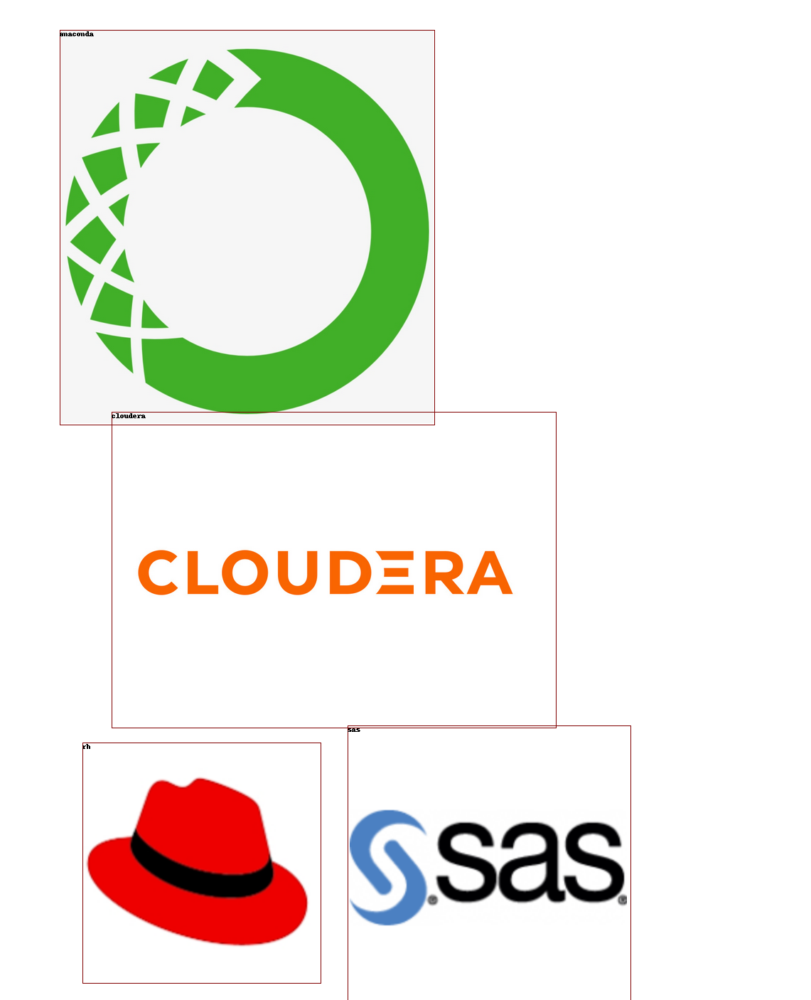

In [134]:
img_name = 'summitlogos.png'
img = Image.open(img_name).convert('RGB')

pred_outputs = predictor(np.array(img))

pred_boxes = pred_outputs['instances']._fields['pred_boxes'].tensor.cpu().numpy()
pred_labels = [labels[i.item()] for i in pred_outputs['instances']._fields['pred_classes']]
pred_scores = pred_outputs['instances']._fields['scores'].cpu().numpy()

visualize_pred(img, pred_boxes, pred_labels, pred_scores)